In [1]:
import os
import numpy as np
import pandas as pd
import scanpy as sc
res_dir = r'U:\Scientific Data\RG-AS04-Data01\Yinan\23-11-14\Result\Reprocess_EVL_expand_1pix'
fig_dir = r'U:\Scientific Data\RG-AS04-Data01\Yinan\23-11-14\Presentation\Reprocess'
rotation = {'E1':120, 'E2':67}

In [2]:
def rot_dots(X, rot):
    theta = np.radians(rot)
    X2d = X[:, 1:3]
    [cx, cy] = np.mean(X2d, axis=0)
    rotation_matrix = np.array([[np.cos(theta), -np.sin(theta)],
                                [np.sin(theta), np.cos(theta)]])
    X2d_rot = np.dot(X2d - np.array([cx, cy]), rotation_matrix.T) + np.array([cx, cy]) 
    X_rot = X.copy()
    X_rot[:, 1:3] = X2d_rot
    return(X_rot)

def convert_to_scdata(res_dir, eid, rotation):
    ctdata = pd.read_csv(res_dir + os.sep + 'sc_data_' + eid + '.csv', index_col=0)
    nucdata = pd.read_csv(res_dir + os.sep + 'nuc_data_' + eid + '.csv', index_col=0)
    celldata = pd.read_csv(res_dir + os.sep + 'celldata_' + eid + '_nucmapped.csv', index_col=0)
    
    blank_ct = ctdata['_blank']
    ctdata = ctdata.drop(['_blank'], axis=1)
    nucdata = nucdata.drop(['_blank'], axis=1)
    
    scdata = sc.AnnData(ctdata)
    celldata_ = celldata.loc[ctdata.index]
    scdata.obs["global_z"] = np.array(celldata_["global_z"])
    scdata.obs["global_x"] = np.array(celldata_["global_x"])
    scdata.obs["global_y"] = np.array(celldata_["global_y"])
    scdata.obs["cellvol"] = np.array(celldata_["cellvol"])
    scdata.obs['batch'] = eid
    scdata.obs['cell_id'] = ctdata.index
    scdata.obs['blank_ct'] = np.array(blank_ct)
    
    Xcms = np.array(scdata.obs[['global_z', 'global_x', 'global_y']])
    Xcms[:, 1:] *= 0.108
    Xcms[:, 0] *= 0.3
    Xcms = rot_dots(Xcms, rotation[eid])
    Xcms[:, 2] = -Xcms[:, 2] 

    scdata.obsm['spatial'] = Xcms[:, [1, 2, 0]]
    
    scdata.layers['spliced'] = np.array(ctdata.loc[scdata.obs_names.astype(float)]- nucdata.loc[scdata.obs_names.astype(float)])
    scdata.layers['unspliced'] = np.array(nucdata.loc[scdata.obs_names.astype(float)])
    
    scdata.obs_names = eid + '_' + scdata.obs_names
    return scdata

In [3]:
scdata_E1 = convert_to_scdata(res_dir, 'E1', rotation)
scdata_E2 = convert_to_scdata(res_dir, 'E2', rotation)

C:\Users\wan0000\AppData\Roaming\Python\Python39\site-packages\anndata\_core\anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
C:\Users\wan0000\AppData\Roaming\Python\Python39\site-packages\anndata\_core\anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [4]:
scdata_E2.obsm['spatial'][:, 1] += np.median(scdata_E1.obsm['spatial'][:, 1]) - np.median(scdata_E2.obsm['spatial'][:, 1])
scdata_E2.obsm['spatial'][:, 0] += np.max(scdata_E1.obsm['spatial'][:, 0]) - np.min(scdata_E1.obsm['spatial'][:, 0]) + 100
scdata_E2.obsm['spatial'][:, 2] = -scdata_E2.obsm['spatial'][:, 2] #align dorsal axes

In [5]:
scdata = sc.concat([scdata_E1, scdata_E2])

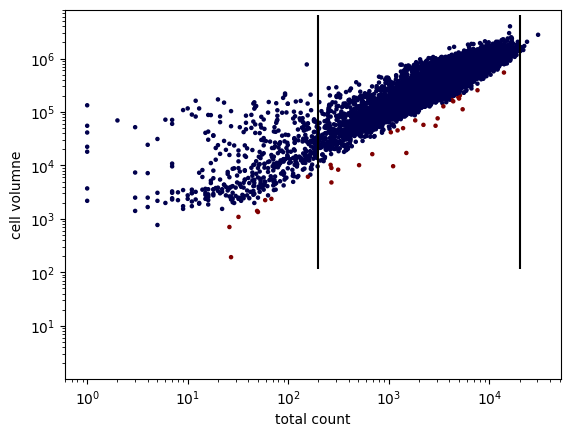

In [6]:
import matplotlib.pyplot as plt
ratio = np.sum(scdata.X, axis=1)/scdata.obs['cellvol']
q1 = np.percentile(ratio, 25)
q3 = np.percentile(ratio, 75)
whis = 4
outlier = (ratio<q1-whis*(q3-q1)) | (ratio>q3+whis*(q3-q1))

plt.scatter(np.sum(scdata.X, axis=1), scdata.obs['cellvol'], 5, c=outlier, cmap='seismic') # 'c' specifies the colors, 'cmap' is the colormap
plt.xscale('log')
plt.yscale('log')
plt.xlabel('total count')
plt.ylabel('cell volumne')

ct_cutoff = [200, 20000]
plt.vlines(ct_cutoff, plt.ylim()[0],  plt.ylim()[1], color='k')

In [7]:
#todo: filter out cells with low count
scdata = scdata[~outlier]
sc.pp.filter_cells(scdata, min_counts=ct_cutoff[0])
sc.pp.filter_cells(scdata, max_counts=ct_cutoff[1])
sc.pp.filter_cells(scdata, min_genes=5)
#calculated based on each cell contains 0.5 blank per cell per gene, so a typical cell should have at least 250 transcripts

volume = np.array(scdata.obs['cellvol'])
scdata.X = scdata.X/volume[:,np.newaxis]*np.median(volume)
scdata.obsm["X_raw"] = scdata.X.copy()

C:\Users\wan0000\AppData\Roaming\Python\Python39\site-packages\scanpy\preprocessing\_simple.py:137: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['n_counts'] = number


In [8]:
print('# cells in E1:', np.sum(scdata.obs['batch']=='E1'))
print('# cells in E2:', np.sum(scdata.obs['batch']=='E2'))

# cells in E1: 22475
# cells in E2: 25858


In [9]:
sc.set_figure_params(dpi=300, dpi_save=300, frameon=False)
save_dir = fig_dir + os.sep + 'Genes_Joint' + os.sep
sc.settings.figdir = save_dir
sc.settings.verbosity = 0

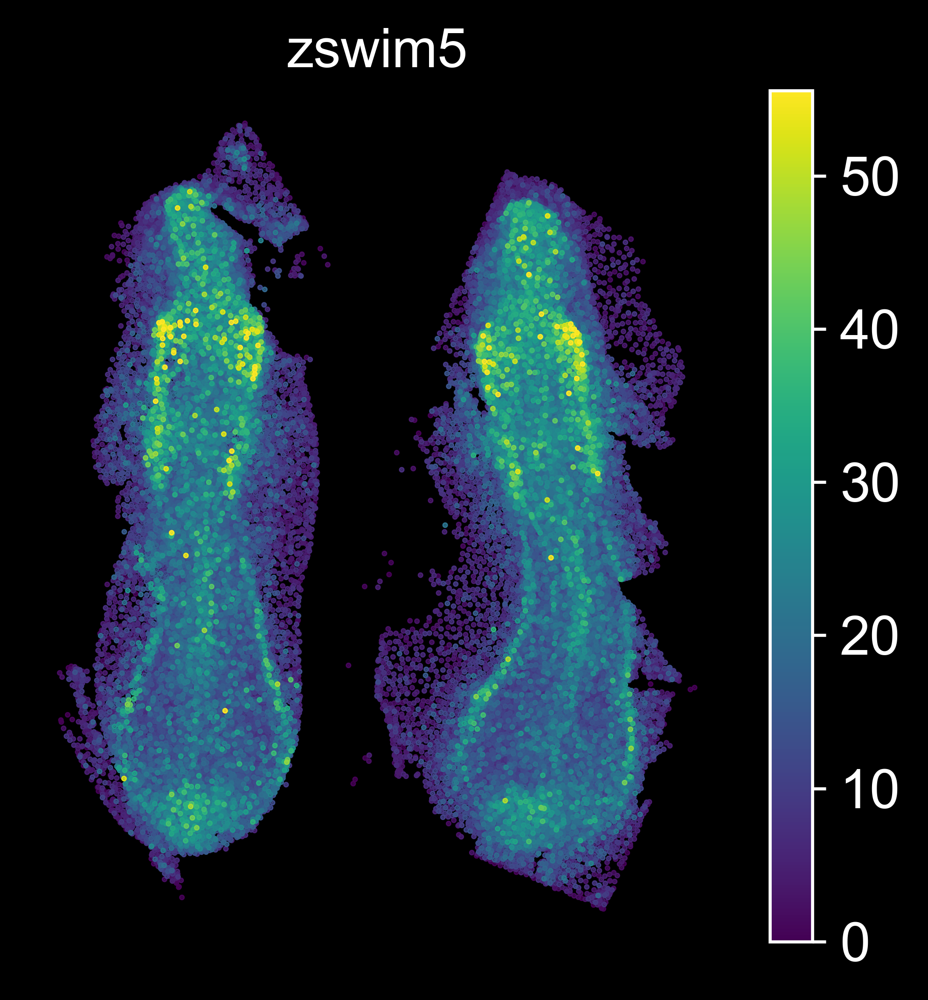

In [10]:
# Save gene expression data
from tqdm import tqdm
genes = list(scdata.var_names.astype(str))
if not os.path.exists(save_dir):
    os.mkdir(save_dir)
plt.style.use('dark_background')
for ig, gn in enumerate(genes):  # Use this to set figure params like size and dpi
#for ig, gn in enumerate(genes[:1]):   
    fl = os.path.join(save_dir, gn.replace(':', '-') + '.png')
    
    #if os.path.exists(fl):
    #    continue
    
    plt.clf()  # Clear the current figure
    
    order = np.argsort(scdata.X[:, ig])
    plt.scatter(scdata.obsm['spatial'][order, 0], -scdata.obsm['spatial'][order, 1], s=0.2, c=scdata.X[order, ig], vmin=0, vmax=np.percentile(scdata.X[:, ig], 99.9))
    plt.title(gn)
    plt.axis('equal')
    plt.axis('off')
    plt.colorbar()
    #plt.colorbar(fraction=0.046, pad=0.1)
    #plt.tight_layout(pad=2)
    plt.savefig(fl, dpi=300)


In [9]:
sc.pp.calculate_qc_metrics(scdata, percent_top=None, inplace=True)
sc.pp.normalize_total(scdata)
sc.pp.log1p(scdata)
sc.pp.scale(scdata)
sc.tl.pca(scdata, svd_solver='arpack')

In [36]:
nn = 20
sc.pp.neighbors(scdata, n_neighbors=nn, n_pcs=50)
#sc.pp.neighbors(scdata, n_neighbors=10, use_rep = "X")#, n_pcs=50)
### Should we do z-scores. Explore this with spatial maps. Visual inspection.
sc.tl.umap(scdata,random_state=9)

In [37]:
leiden_res = 5
sc.tl.leiden(scdata, resolution=leiden_res) 

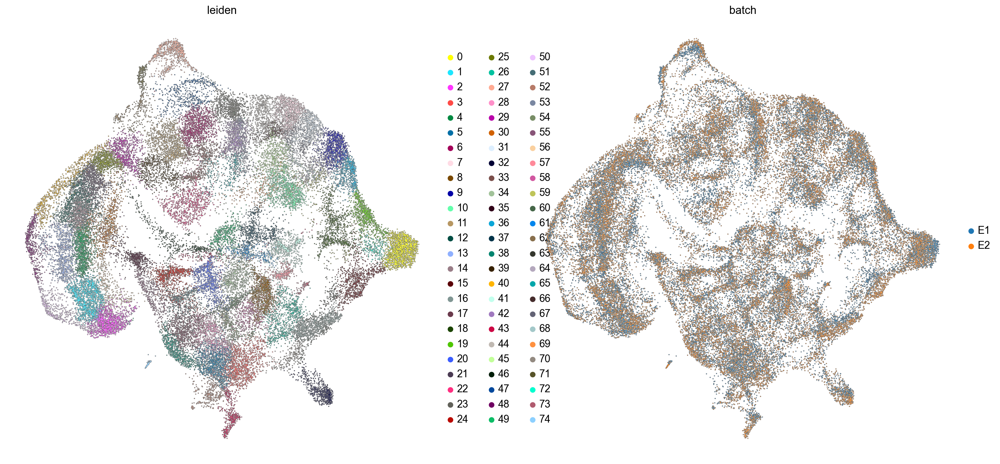

In [38]:
import matplotlib.pyplot as plt
plt.style.use('default')
sc.set_figure_params(figsize=(10,10))
sc.pl.umap(
    scdata,
    color=['leiden', 'batch'],
    add_outline=True,
    frameon=False,
)

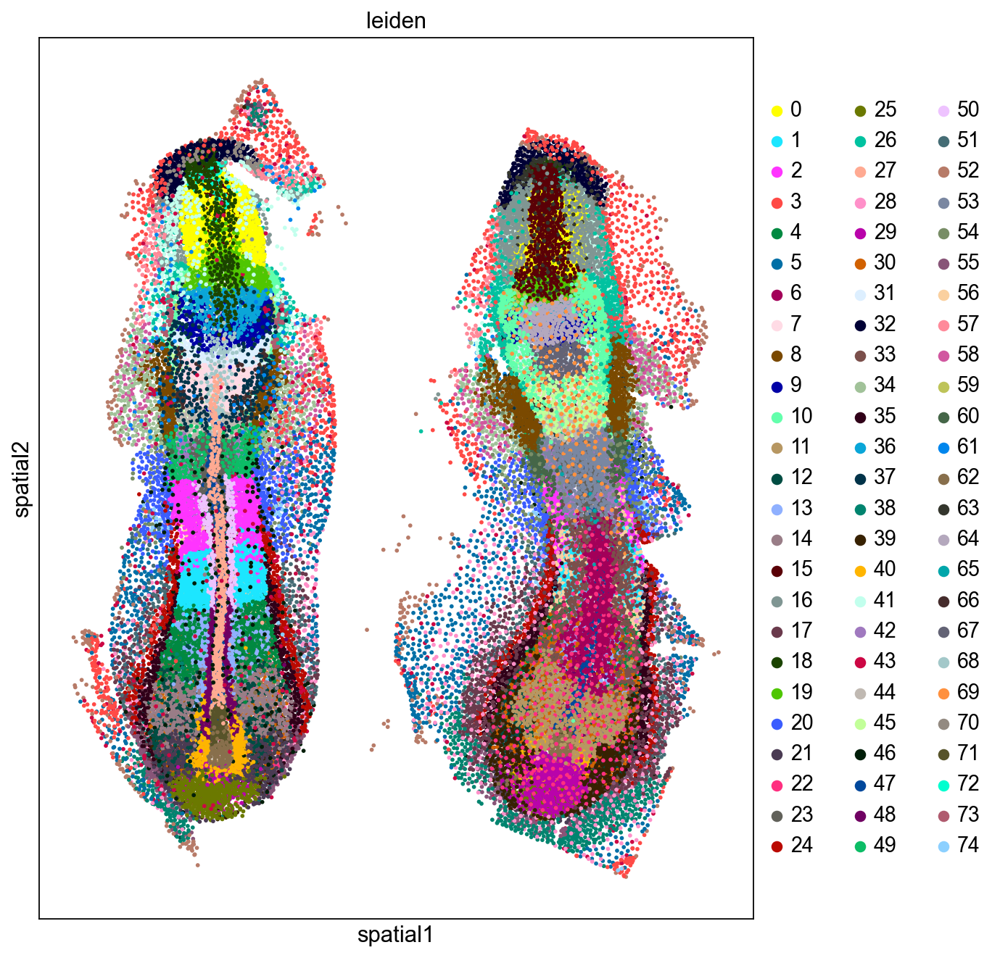

In [39]:
sc.pl.spatial(scdata, color='leiden', spot_size=10)

In [55]:
df_expression = pd.DataFrame(scdata.X, index=scdata.obs.index, columns=scdata.var_names)

# Add the 'leiden' cluster assignments as a column in the DataFrame
df_expression['leiden'] = scdata.obs['leiden']

# Calculate the mean expression per cluster for each gene
cluster_means = df_expression.groupby('leiden').mean()

In [85]:
cluster_means['noto'].sort_values().tail(n=10)

leiden
15    0.404659
30    0.564156
19    0.632889
39    0.661404
70    0.864271
63    0.874526
59    1.180749
11    1.688189
62    2.714795
71    3.693024
Name: noto, dtype: float64

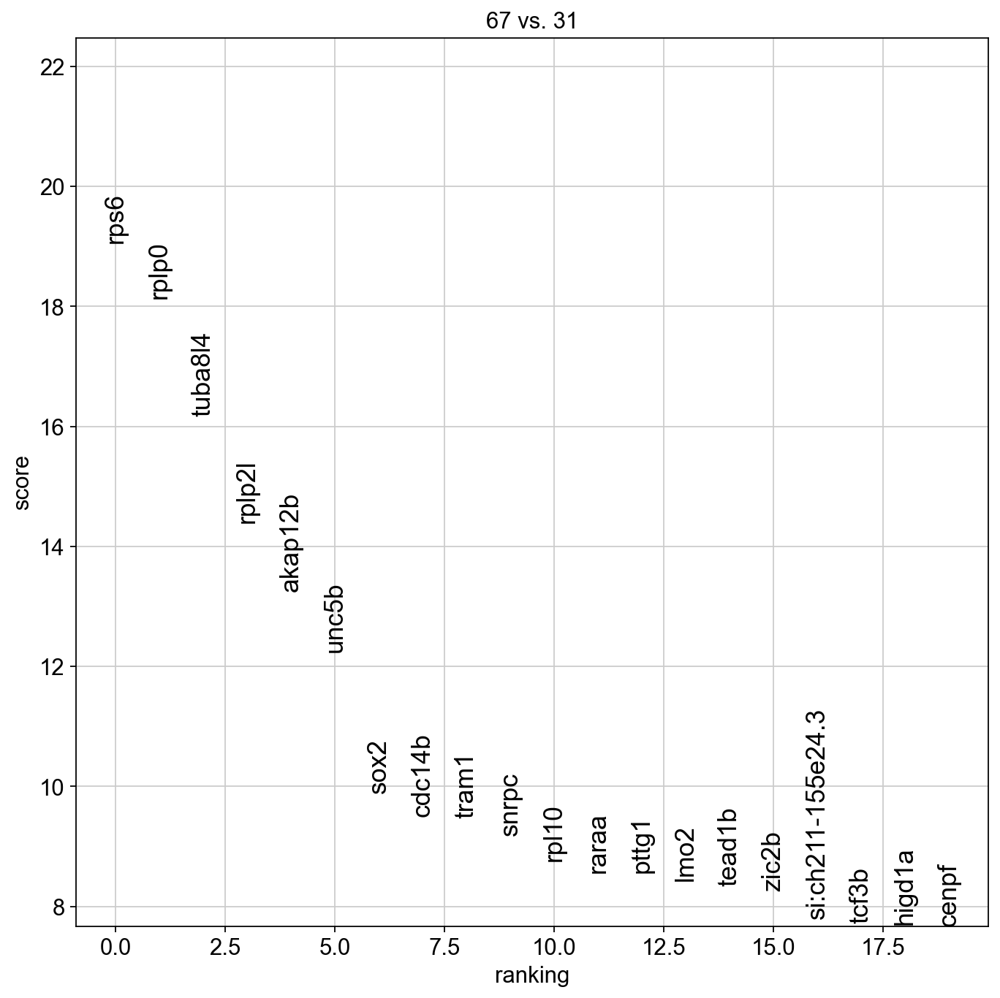

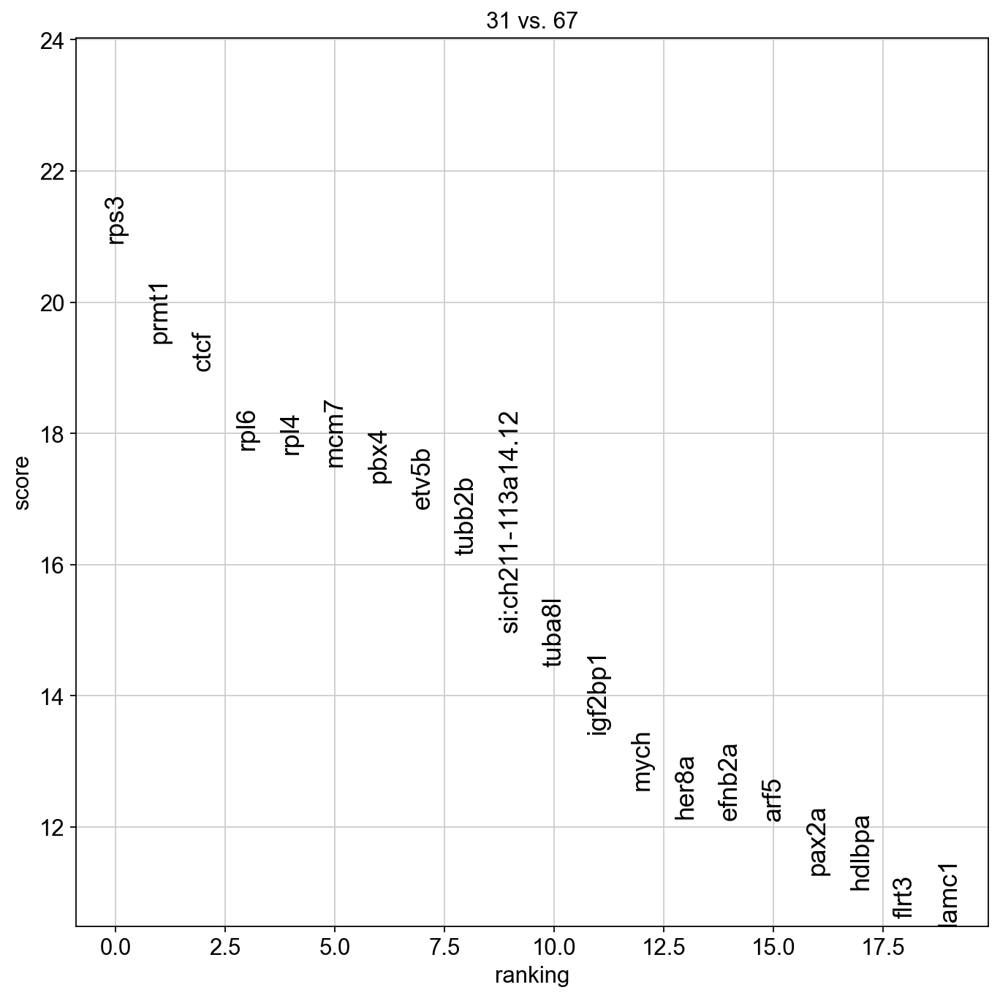

In [146]:
clusters_to_compare = ['67', '31']
sc.tl.rank_genes_groups(scdata, groupby='leiden', groups=clusters_to_compare[:-1], method='wilcoxon', reference=clusters_to_compare[-1])
sc.pl.rank_genes_groups(scdata, groups=clusters_to_compare[:-1], n_genes=20, fontsize=16)

sc.tl.rank_genes_groups(scdata, groupby='leiden', groups=clusters_to_compare[1:], method='wilcoxon', reference=clusters_to_compare[0])
sc.pl.rank_genes_groups(scdata, groups=clusters_to_compare[1:], n_genes=20, fontsize=16)

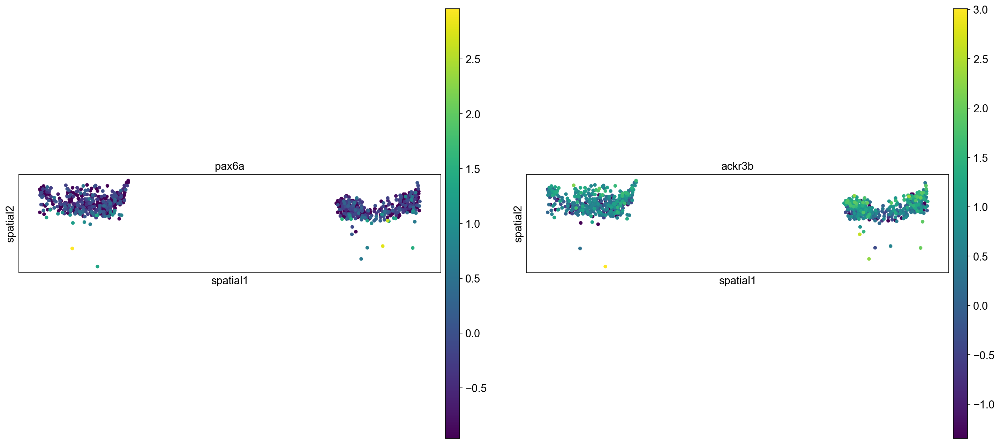

In [78]:
sc.pl.spatial(scdata[scdata.obs['leiden']=='31'], color=['pax6a', 'ackr3b'], spot_size=10)

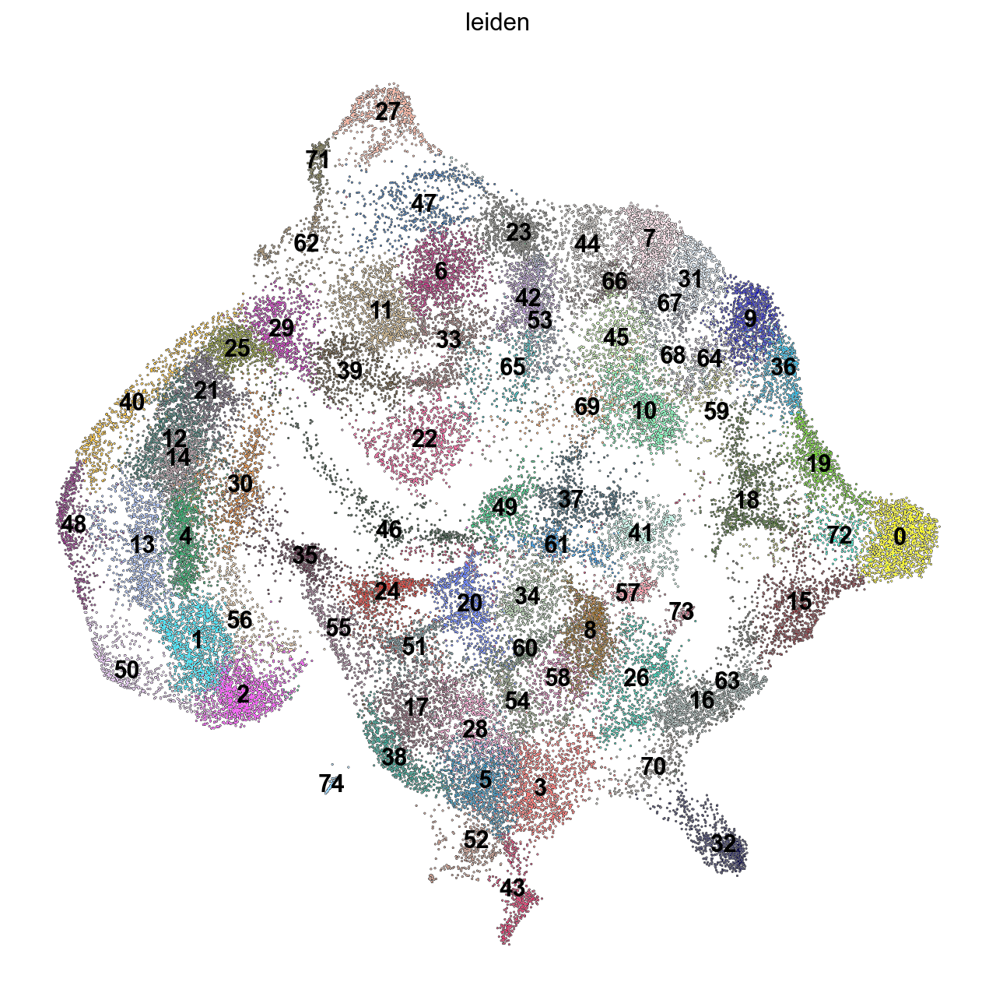

In [40]:
import matplotlib.pyplot as plt
plt.style.use('default')
sc.set_figure_params(figsize=(10,10))
sc.pl.umap(
    scdata,
    color='leiden',
    add_outline=True,
    frameon=False,
    legend_loc = 'on data',
)

In [15]:
cms = scdata.obsm['spatial'][:, [2, 0, 1]]
clusters = scdata.obs['leiden'].cat.categories
cmap = ['m', 'b', 'r', 'y', 'g', 'c', 'w']
import napari
viewer = napari.Viewer()
for icl, cl in enumerate(clusters):
    kp_cl = scdata.obs['leiden']==cl
    viewer.add_points(cms[kp_cl], size=5, face_color=cmap[icl % len(cmap)], name='cluster '+cl)

E:\Anaconda3\envs\scanpy_env\lib\site-packages\numpy\core\numeric.py:2463: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return bool(asarray(a1 == a2).all())
E:\Anaconda3\envs\scanpy_env\lib\site-packages\numpy\core\numeric.py:2463: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return bool(asarray(a1 == a2).all())
E:\Anaconda3\envs\scanpy_env\lib\site-packages\numpy\core\numeric.py:2463: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return bool(asarray(a1 == a2).all())
E:\Anaconda3\envs\scanpy_env\lib\site-packages\numpy\core\numeric.py:2463: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return bool(asarray(a1 == a2).all())
E:\Anaconda3\envs\scanpy_env\lib\site-pa

In [124]:
v2 = napari.Viewer()
for icl, cl in enumerate(['25', '29', '21', '39']):
    kp_cl = scdata.obs['leiden']==cl
    v2.add_points(cms[kp_cl], size=5, face_color=cmap[icl % len(cmap)], name='cluster '+cl)

In [16]:
sc.tl.rank_genes_groups(scdata, "leiden", method="t-test")
plt.style.use('default')
sc.pl.rank_genes_groups(scdata, n_genes=20, sharey=False, fontsize=16)

C:\Users\wan0000\AppData\Roaming\Python\Python39\site-packages\scanpy\tools\_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
C:\Users\wan0000\AppData\Roaming\Python\Python39\site-packages\scanpy\tools\_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
C:\Users\wan0000\AppData\Roaming\Python\Python39\site-packages\scanpy\tools\_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
C:\Users\wan0000\AppData\Roaming\Python\Python39\site-packages\scanpy\tools\_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
C:\Users\wan0000\AppData\Roaming\Python\Python39\site-packages\scanpy\tools\_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_

In [24]:
sc.write(res_dir + os.sep + 'scdata_all.h5ad', scdata)

In [23]:
# Write out clusters as segmentation mask
eid = 'E1'
import tifffile
unif_mask = tifffile.imread(res_dir + os.sep + eid + '_unif_mask_ds4_nucmapped.tif')

In [24]:
dict_cell_leiden = dict(zip(scdata[scdata.obs['batch']==eid].obs['cell_id'], scdata[scdata.obs['batch']==eid].obs['leiden'].astype(np.int16) + 1))
unif_mask_leiden = np.vectorize(dict_cell_leiden.get)(unif_mask, 0)

In [25]:
tifffile.imwrite(res_dir + os.sep + eid + '_leiden-5_mask_ds4_nucmapped.tif', unif_mask_leiden.astype(np.int16))

In [27]:
v1 = napari.Viewer()
resc=4
mem_img = tifffile.imread(res_dir + os.sep + eid + '_mem_stitched_ds' + str(resc) +'.tif')
v1.add_image(mem_img, name='mem_stitched')
cmap = ['m', 'b', 'r', 'y', 'g', 'c', 'w']
#v1.add_labels(unif_mask_leiden.astype(int), name = 'leiden')
for ic, c in enumerate(np.arange(1, np.max(unif_mask_leiden)+1)):
    v1.add_labels(unif_mask_leiden==c.astype(int), name = 'leiden_'+str(c-1), color={1:cmap[ic % len(cmap)]})

In [30]:
v1.add_labels(unif_mask, name = 'seg_mask')
v1.add_labels(unif_mask_leiden, name='leiden_all')

<Labels layer 'leiden_all' at 0x21d0a019970>

In [112]:
img_dapi = tifffile.imread(res_dir + os.sep + eid + '_dapi_stitched_ds4.tif')
v1.add_image(img_dapi)

<Image layer 'img_dapi' at 0x1d61edc32e0>

In [17]:
data_dir = r'U:\Scientific Data\RG-AS04-Data01\Yinan\sc_data'
sc_dir = data_dir + os.sep + 'URD'
imputated_dir = data_dir + os.sep + 'URD_Mapping_Result'
ad_map = sc.read_h5ad(imputated_dir + os.sep + 'C_6s_map_reprocess.h5ad')
rna_adata = sc.read_h5ad(sc_dir + os.sep + 'URD_annotated.h5ad')

In [18]:
import pandas as pd
cluster6s = pd.read_csv(sc_dir + os.sep + 'cluster_6S.csv', index_col=0)
cluster6s.index = rna_adata.obs_names
rna_adata.obs['cluster_6s'] = cluster6s['x'].astype('category')

import tangram as tg
spatial_adata_use = scdata[scdata.obs['batch']=='E1'].copy()
#spatial_adata_use.obs_names = 'C_6s_' + spatial_adata_use.obs_names
tg.project_cell_annotations(ad_map, spatial_adata_use, annotation="cluster_6s")

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [41]:
import numpy as np
m_clusters = spatial_adata_use.obsm['tangram_ct_pred']
m_clusters = np.array(m_clusters)

m_leiden = pd.get_dummies(scdata[scdata.obs['batch']=='E1'].obs['leiden'].copy(), columns = scdata.obs['leiden'].cat.categories)
leiden_c = m_leiden.columns
m_leiden = np.array(m_leiden)

corr_matrix = np.zeros((m_clusters.shape[1], m_leiden.shape[1]))

# Iterate over columns of m_clusters and m_leiden to compute correlation
for i in range(m_clusters.shape[1]):
    for j in range(m_leiden.shape[1]):
        corr_matrix[i, j] = np.corrcoef(m_clusters[:, i], m_leiden[:, j])[0, 1]        
        #corr_matrix[i, j] = np.sum(m_clusters[:, i] * m_leiden[:, j])
corr_matrix[1, :] = 0

In [42]:
leiden_s = 'leiden-' + str(leiden_res)
# Write out clusters as annotation file, skip if already processed
anno_file = pd.DataFrame(columns=[leiden_s, 'clusters-URDmapped'])
#anno_file['leiden-5'] = scdata.obs['leiden'].cat.categories
anno_file[leiden_s] = leiden_c
anno_file['clusters-URDmapped'] = spatial_adata_use.obsm['tangram_ct_pred'].columns[np.argmax(corr_matrix, axis=0)]
anno_file.to_csv(res_dir + os.sep + 'cluster_annotation_'+ leiden_s + '.csv', index=False)

In [4]:
import pandas as pd
leiden_s = 'leiden-5'

In [5]:
anno = pd.read_excel(res_dir + os.sep +  'cluster_annotation_'+ leiden_s + '.xlsx')

In [10]:
dict_cells = dict(zip(anno['leiden-5'].astype(str), anno['clusters-annotated']))
dict_cells

{'27': 'Notochord Anterior',
 '32': 'Prechordal Plate',
 '62': 'Notochord Posterior Tip - posterior',
 '70': 'Prechordal Plate',
 '71': 'Notochord Posterior Tip - anterior',
 '46': 'Endoderm Pancreatic/Intestinal',
 '61': 'Endoderm Pharyngeal',
 '22': 'EVL/Periderm',
 '28': 'EVL/Periderm',
 '43': 'YSL',
 '45': 'EVL/Periderm',
 '52': 'EVL + autofluorescence',
 '54': 'EVL/Periderm',
 '59': 'EVL/Periderm',
 '69': 'EVL/Periderm',
 '37': 'Cephalic Mesoderm - middle',
 '41': 'Cephalic Mesoderm - anterior',
 '49': 'Cephalic Mesoderm - posterior',
 '20': 'Heart Primordium - posterior',
 '24': 'Pronephros - anterior',
 '34': 'Heart Primordium - anterior',
 '35': 'Hematopoeitic (ICM)',
 '51': 'Ventral LPM',
 '55': 'Pronephros - posterior',
 '57': 'Hematopoeitic (RBI)',
 '0': 'Optic Cup',
 '6': 'Spinal Cord',
 '7': 'Hindbrain R3+4',
 '9': 'Midbrain',
 '10': 'Neural Crest',
 '11': 'Spinal Cord',
 '15': 'Telencephalon Dorsal',
 '18': 'Forebrain Ventral',
 '19': 'Diencephalon',
 '23': 'Hindbrain R7'

In [6]:
annotation = ['clusters', 'germlayer', 'type', 'tissue']
columns = ['clusters-annotated', 'Level 1 - Germlayer', 'Level 2 - Type', 'Level 3 - Tissue']

for feat, col in zip(annotation, columns):
    dict_cells = dict(zip(anno['leiden-5'], anno[col]))
    scdata.obs[feat] = np.vectorize(dict_cells.get)(scdata.obs['leiden'].astype(int))

NameError: name 'scdata' is not defined

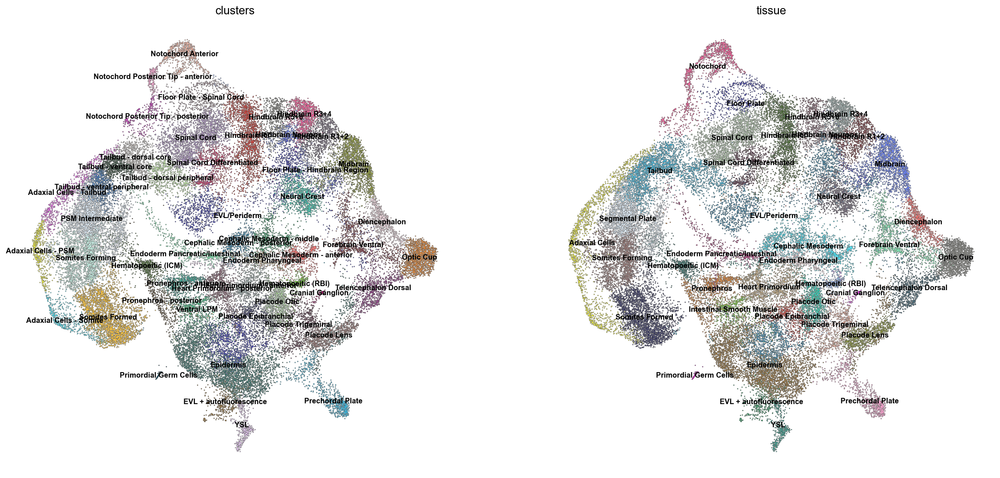

In [149]:
plt.style.use('default')
sc.set_figure_params(figsize=(10,10))
sc.pl.umap(
    scdata,
    color=['clusters', 'tissue'],
    legend_loc="on data",
    add_outline=True,
    frameon=False,
    legend_fontsize=9
)

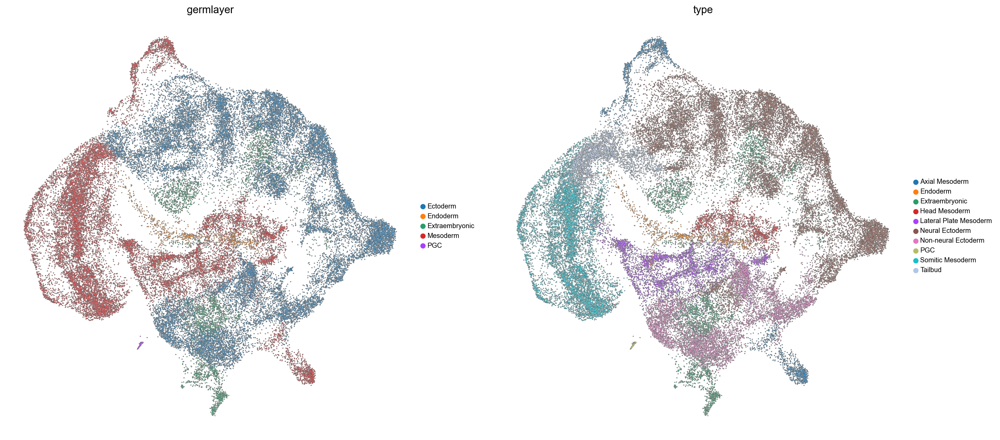

In [151]:
plt.style.use('default')
sc.set_figure_params(figsize=(10,10))
sc.pl.umap(
    scdata,
    color=['germlayer', 'type'],
   # legend_loc="right",
    add_outline=True,
    frameon=False,
    legend_fontsize=9
)

In [155]:
sc.write(res_dir + os.sep + 'scdata_all.h5ad', scdata)

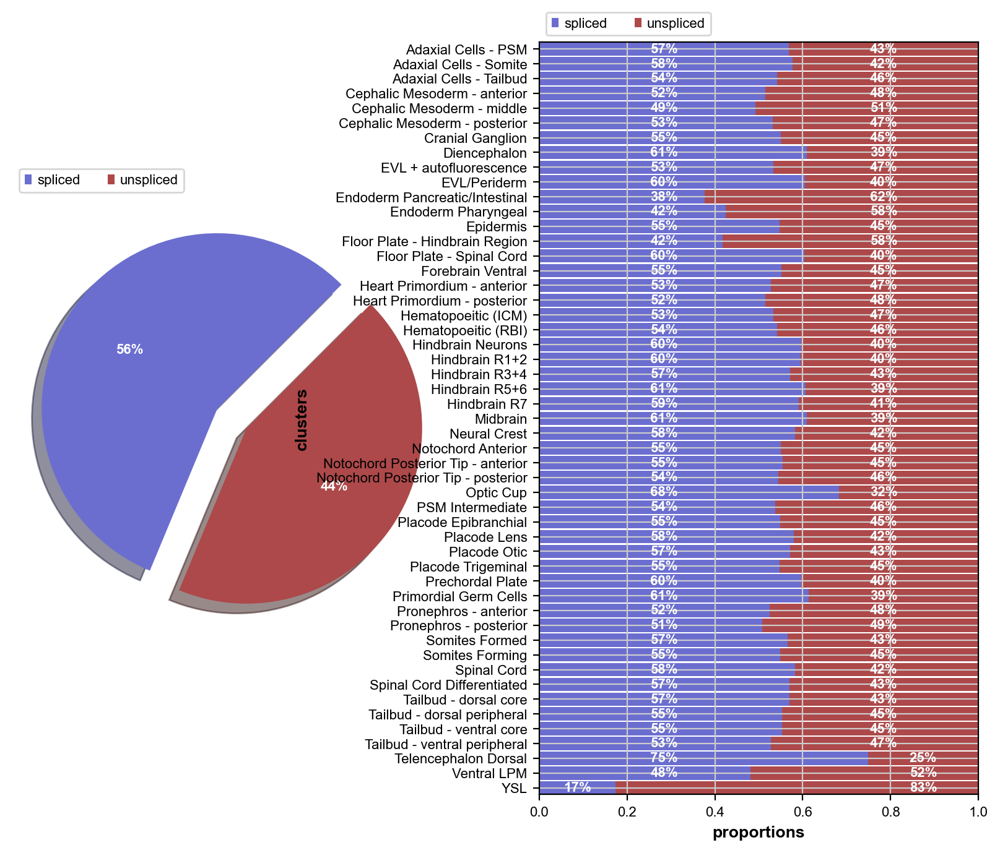

In [154]:
import scvelo as scv
scv.pl.proportions(scdata, figsize=(10, 8), groupby='clusters')